## This Notebook provides an example of the workflow to apply the Spectral Subtraction-based Denoising workflow, on FORGE DAS data

Reference paper:

***Pascucci, G., Gaviano, S., Pozzoli, A., Grigoli, F. (2025): Signal Enhancement of Distributed Acoustic Sensing data using a Spectral Subtraction-based Approach. Seismological Research Letters, doi: xxx.xxx.xxx***

Contact: giulio.pascucci@phd.unipi.it

---

Load DAS_class to read and process the DAS data

In [ ]:
from DAS_class import *

Zenodo link to download the .tdms file used in this example: 

*Giulio Pascucci. (2025). Utah FORGE April 2022 .tdms DAS data: FORGE_DFIT_UTC_20220421_144609.398.tdms [Data set]. Zenodo. https://doi.org/10.5281/zenodo.17554490*

### Get and load FORGE DAS data (April 2022 Stimulation)

In [ ]:
# Example how to download the data linked above 
# (this will be downloaded in your current working directory):

import urllib.request
fname = 'FORGE_DFIT_UTC_20220421_144609.398.tdms'  #file to download
url = "https://zenodo.org/records/17554490/files/FORGE_DFIT_UTC_20220421_144609.398.tdms"
urllib.request.urlretrieve(url, fname)    #this will download the file, it will take a while

### Define the DAS object and pre-processing parameters

In [84]:
file=f'./{fname}'
file_format = 'tdms'

dx = 1.02       # channel spacing
gl = 10.        # gauge length
dt = 0.00025    # new sampling rate to downsample FORGE data (fs=4000Hz)

forge = DAS(file, dx, gl, file_format)

[nptdms.tdms_segment WARNING] Data size 291840000 is not a multiple of the chunk size 1050624. Will attempt to read last chunk


Reading : ./FORGE_DFIT_UTC_20220421_144609.398.tdms


In [85]:
tini = 0        # starting time (in seconds, relative time)
tend = 15       # ending time (in s)
xini = 1350     # first channel
xend = 2400     # last channel

# Cut data in a 15-second chunk
forge.data_select(tini, tend, xini, xend)

# Pre-process ( fk filter to remove k=0 component and badpass [5-250Hz] )
ftype = 'bandpass'
fmin, fmax, fkmax = 5, 200, 200
order = 4                    # order of the butterworth bandpass filter
fk = True
K_out, K_inn = None, None    # Define cone around k=0 
perc_fk = 1
tapering=True                # Add a tapering around bandpass filter limits

forge.preprocess(forge.traces, forge.sam_rate_raw, ftype, fmin, fmax, fk, fkmax, order, K_out, K_inn, perc_fk, tapering)

Visualize the raw DAS data 

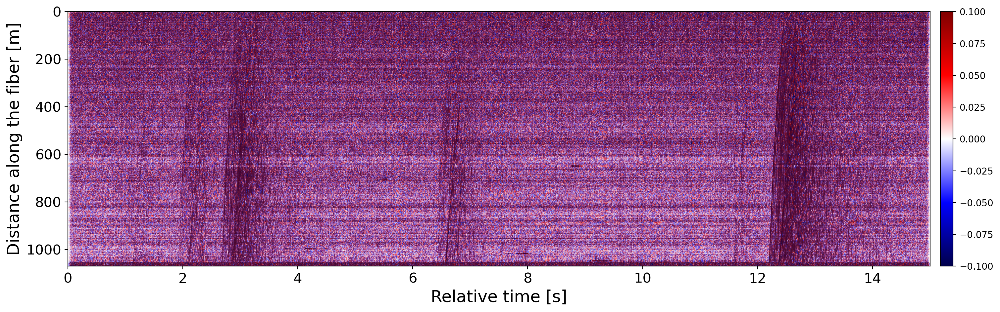

In [86]:
val = 0.1 #defines the min/max plotting limits
forge.visualize(forge.traces, f'raw__{fname[:-5]}', vmin=-val, vmax=val)

### Define the Over Subtraction (OS) denoising parameters:

In [87]:
# set basic parameters
params = {
    'frame_duration' : 0.06 ,   #in seconds
    'dt'             : dt,
    'noise_duration' : 1.5 ,    #in seconds
    'G'              : 0.9 , 
    'Thresh'         : 4 ,
    'beta'           : 0.002 ,
    'window'         : 'hamming' 
    }

### Run the OS Denoising Workflow

In [88]:
forge.run_OS_DAS_denoiser(forge.traces, **params)

Using first 25 frames (~1.50s) for noise spectrum estimation.


Processing Channel: 100%|██████████| 1050/1050 [00:29<00:00, 36.20it/s]


array([[-0.00015455, -0.0001404 , -0.0001196 , ...,  0.        ,
         0.        ,  0.        ],
       [ 0.00024072,  0.00026612,  0.00029088, ...,  0.        ,
         0.        ,  0.        ],
       [ 0.00046517,  0.00046392,  0.0004663 , ...,  0.        ,
         0.        ,  0.        ],
       ...,
       [ 0.00016253,  0.00018974,  0.00021107, ...,  0.        ,
         0.        ,  0.        ],
       [-0.00087565, -0.00094624, -0.00094494, ...,  0.        ,
         0.        ,  0.        ],
       [-0.00015565, -0.00020982, -0.00022859, ...,  0.        ,
         0.        ,  0.        ]], shape=(1050, 60000))

### Run the OS Denoising Workflow (with SSNR output)

Visualize the denoised result

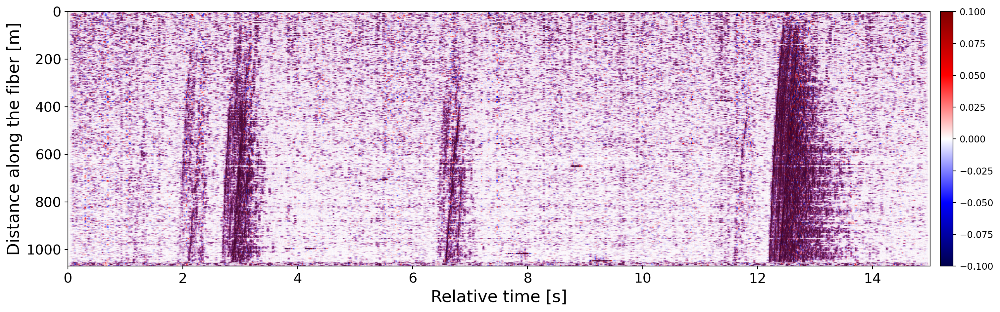

In [89]:
val = 0.1
forge.visualize(forge.denoised, f'os__{fname[:-5]}', vmin=-val, vmax=val, cmap='seismic')

Visualize the removed noise from the raw data

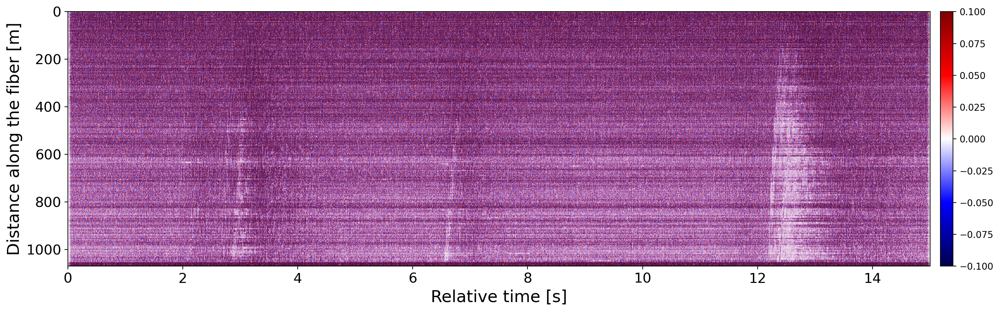

In [90]:
forge.visualize(forge.denoised - forge.traces, f'diff__{fname[:-5]}', vmin=-val, vmax=val, cmap='seismic')

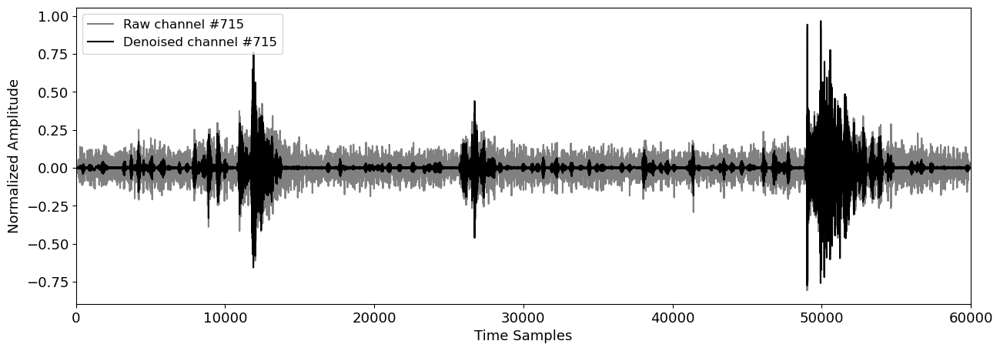

In [109]:
ch = np.random.randint(len(forge.traces)) #select a random channel to plot

plt.figure(figsize=(15,5))
plt.plot(forge.traces[ch,:], color='gray', label=f'Raw channel #{ch}')
plt.plot(forge.denoised[ch,:], color='black', label=f'Denoised channel #{ch}')
plt.ylabel('Normalized Amplitude', fontsize=13)
plt.xlabel('Time Samples', fontsize=13)
plt.gca().tick_params(axis='both',labelsize=13)
plt.xlim(0, forge.traces.shape[1])
plt.legend(fontsize=12, loc='upper left')
plt.show()